In [1]:
## Ues For intal Processor 
# !pip install -r requirements.txt
## Use requirements_silicon.txt for silicon Processor (M1,M2,M3 ,ect..)
# !pip install -r requirements_silicon.txt

In [ ]:
import os
import numpy as np
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from PIL import Image
from collections import Counter
import tensorflow as tf
from tensorflow.keras import layers, Model,models
from tensorflow.keras.losses import CategoricalCrossentropy
from tensorflow.keras.models import load_model
# from tensorflow.keras.metrics import Metric, MeanIoU
from collections import Counter
import rasterio
import albumentations as A
from tensorflow.keras.applications import ResNet50
# import tensorflow_addons as tfa

In [87]:
# ----------------------- DATA UTILITY FUNCTIONS ----------------------- #

def load_paths(file_path):
    """Load paths from a text file and return as a list."""
    with open(file_path, "r") as f:
        # print(f"Processing: {[os.path.abspath(line.strip()) for line in f.readlines()]}")
        return [os.path.abspath(line.strip()) for line in f.readlines()]

In [88]:
# ---------------------- CONFIGURATION ---------------------- #
IMG_SIZE = (256, 256)
NUM_CLASSES = 16  
BATCH_SIZE = 32
EPOCHS = 120

# ---------------------- CLASS MAPPINGS ---------------------- #
class_mapping = {
    1: 'Marine Debris',
    2: 'Dense Sargassum',
    3: 'Sparse Sargassum',
    4: 'Natural Organic Material',
    5: 'Ship',
    6: 'Clouds',
    7: 'Marine Water',
    8: 'Sediment-Laden Water',
    9: 'Foam',
    10: 'Turbid Water',
    11: 'Shallow Water',
    12: 'Waves',
    13: 'Cloud Shadows',
    14: 'Wakes',
    15: 'Mixed Water',
    0:'Unknown Class'
}
color_mapping = {
    1: (255, 0, 0),      # Marine Debris - Red
    2: (0, 128, 0),      # Dense Sargassum - Green
    3: (255, 255, 224),  # Foam - Light Yellow 
    4: (139, 69, 19),    # Natural Organic Material - Brown
    5: (128, 128, 128),  # Ship - Gray (Neutral and clear)
    6: (255, 255, 255),  # Clouds - White
    7: (0, 0, 255),      # Marine Water - Blue
    8: (210, 180, 140),  # Sediment-Laden Water - Tan
    9: (144, 238, 144),  # Sparse Sargassum - Light Green
    10: (64, 224, 208),  # Turbid Water - Turquoise
    11: (176, 224, 230), # Shallow Water - Powder Blue
    12: (0, 191, 255),   # Waves - Deep Sky Blue
    13: (105, 105, 105), # Cloud Shadows - Dim Gray
    14: (220, 220, 220), # Wakes - Gainsboro
    15: (70, 130, 180) , # Mixed Water - Steel Blue
    0: (211, 211, 211)  # Unknown background - Light Gray (Soft, neutral tone for unknown areas)
}

confidence_mapping = {
    1: 'High',
    2: 'Moderate',
    3: 'Low',
    0:'background',
}

# ِAnalysis

In [89]:

def find_unique_in_raw_masks(mask_paths):
    """
    Finds and returns the sorted set of unique class values across a list of mask files.

    Parameters:
    -----------
    mask_paths : list of str
        Paths to raw mask image files.

    Returns:
    --------
    list of int
        Sorted list of unique class values found across all masks.
    """
    all_classes = set()
    
    for path in mask_paths:
        mask = np.array(Image.open(path))  # or rasterio if needed
        unique = np.unique(mask)
        all_classes.update(unique.tolist())
    return sorted(all_classes)

      
def apply_uncertainty_class(mask, conf, threshold=1):
    """
    Apply an 'uncertain' label (e.g., class 16) to areas in the mask with low confidence.

    Parameters:
    -----------
    mask : np.ndarray
        The segmentation mask.
    conf : np.ndarray
        The corresponding confidence map.
    threshold : int
        Pixels with confidence below this threshold will be labeled as 16.

    Returns:
    --------
    mask : np.ndarray
        Updated mask with uncertain areas marked as class 16.
    """
    uncertain_mask = (conf < threshold)
    mask[uncertain_mask] = 16
    return mask


path_list={'train_masks':"../data/splits/train_masks.txt",
           'val_masks':"../data/splits/val_masks.txt",
           'test_masks':"../data/splits/test_masks.txt",
           }
for key, txt in path_list.items():
    path=load_paths(txt)
    print(f'find unique mask classes in {key} : {find_unique_in_raw_masks(path)}')   

find unique mask classes in train_masks : [0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 11.0, 12.0, 13.0, 14.0, 15.0]
find unique mask classes in val_masks : [0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 11.0, 12.0, 13.0, 14.0, 15.0]
find unique mask classes in test_masks : [0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 11.0, 12.0, 13.0, 14.0, 15.0]


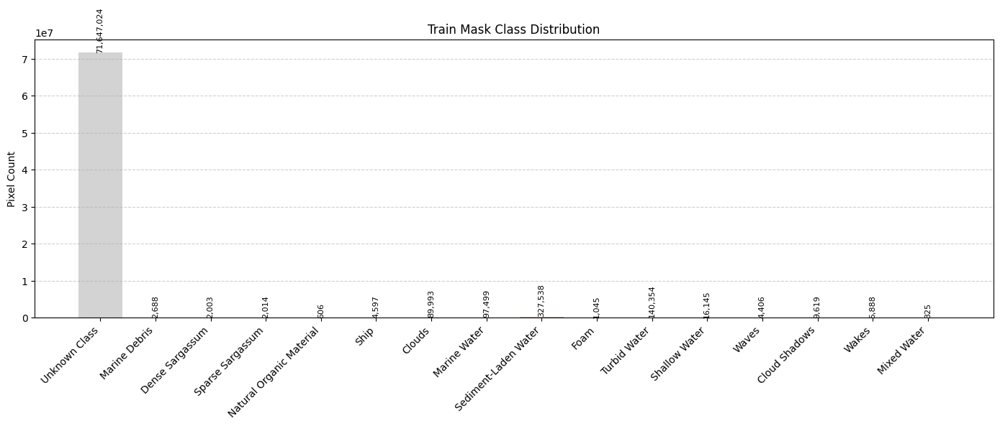

In [90]:
def plot_mask_class_histogram(mask_paths, class_mapping, color_mapping, title="Mask Class Distribution"):
    """
    Load a list of mask paths, count class frequencies, and display a color-coded histogram.

    Parameters:
    -----------
    mask_paths : list of str
        List of file paths to mask images.
    class_mapping : dict
        Mapping from class indices to class names.
    color_mapping : dict
        Mapping from class indices to RGB color codes.
    title : str
        Title for the plot.
    """
    class_counts = Counter()

    for path in mask_paths:
        mask = np.array(Image.open(path))
        unique, counts = np.unique(mask, return_counts=True)
        class_counts.update(dict(zip(unique, counts)))

    # Prepare data for plotting
    sorted_classes = sorted(class_counts.keys())
    labels = [class_mapping.get(c, f"Class {c}") for c in sorted_classes]
    values = [class_counts[c] for c in sorted_classes]
    colors = [np.array(color_mapping.get(c, (128, 128, 128))) / 255.0 for c in sorted_classes]

    # Plot
    plt.figure(figsize=(14, 6))
    bars = plt.bar(range(len(values)), values, color=colors)

    plt.xticks(ticks=range(len(labels)), labels=labels, rotation=45, ha='right')
    plt.ylabel("Pixel Count")
    plt.title(title)
    plt.grid(axis='y', linestyle='--', alpha=0.6)

    # Add counts above bars
    for bar, count in zip(bars, values):
        plt.text(bar.get_x() + bar.get_width() / 2, bar.get_height(), f"{count:,}", 
                 ha='center', va='bottom', fontsize=8, rotation=90)

    plt.tight_layout()
    plt.show()

train_mask_paths = load_paths("../data/splits/train_masks.txt")
plot_mask_class_histogram(train_mask_paths, class_mapping, color_mapping, title="Train Mask Class Distribution")


# Deep Learning Pipeline

In [91]:
# ---------------------- DATA PIPELINE ---------------------- #

class DataPipeline:
    """
    A preprocessing pipeline for satellite image data, including augmentation and band normalization.

    Parameters:
    -----------
    img_size : tuple
        Target size (height, width) for input images.
    num_classes : int
        Number of classes for the segmentation/masking task.
    rare_classes : list or None
        List of class indices that are considered rare (optional).
    normalization_method : str
        Normalization strategy to apply on each band. Options:
            - 'percentile': Scales data between 0–1 using the 2nd and 98th percentiles.
            - 'robust': Normalizes using median and IQR, then clips to [-1, 1].
            - 'minmax': Normalizes using exact min and max values per band.
    """

    def __init__(self, img_size, num_classes, rare_classes=None, normalization_method='robust'):
        self.img_size = img_size
        self.num_classes = num_classes
        self.rare_classes = rare_classes
        self.normalization_method = normalization_method
         
        # Define common augmentations using Albumentations 
        self.augmentation_pipeline = A.Compose([
            A.HorizontalFlip(p=0.5),
            A.VerticalFlip(p=0.5),
            A.RandomRotate90(p=0.5),
            A.RandomBrightnessContrast(p=0.3),
            A.RandomGamma(p=0.3),
            A.GaussNoise(p=0.2),
        ], additional_targets={'mask': 'mask'})
    
    def normalize_band(self, band):
        """
        Normalize a single image band using the configured method.

        Parameters:
        -----------
        band : np.ndarray
            A single spectral band (2D array).

        Returns:
        --------
        normalized_band : np.ndarray
            The normalized band.
        """
        if self.normalization_method == 'percentile':
            min_val, max_val = np.percentile(band, (2, 98))
            normalized_band = np.clip((band - min_val) / (max_val - min_val + 1e-6), 0, 1)

        elif self.normalization_method == 'robust':
            median = np.median(band)
            q1, q3 = np.percentile(band, [25, 75])
            iqr = q3 - q1
            normalized_band = (band - median) / (iqr + 1e-6)
            normalized_band = np.clip(normalized_band, -1, 1)

        elif self.normalization_method == 'minmax':
            min_val, max_val = np.min(band), np.max(band)
            normalized_band = (band - min_val) / (max_val - min_val + 1e-6)

        else:
            raise ValueError("Unsupported normalization method. Choose 'percentile', 'robust', or 'minmax'.")

        return normalized_band.astype(np.float32)

    def load_image(self, image_path):
        """
        Load and normalize multiple bands and compute vegetation/water indices.

        Parameters:
        -----------
        image_path : str
            Path to the satellite image file.

        Returns:
        --------
        image : np.ndarray
            Multi-band image of shape (H, W, 9).
        """
        with rasterio.open(image_path) as src:
            blue = self.normalize_band(src.read(2))
            green = self.normalize_band(src.read(3))
            red = self.normalize_band(src.read(4))
            nir = self.normalize_band(src.read(8))
            swir1 = self.normalize_band(src.read(11))
            
             # Calculate selected indices
            ndvi = (nir - red) / (nir + red + 1e-6)
            ndwi = (green - swir1) / (green + swir1 + 1e-6)
            fdi = nir / (red + swir1 + 1e-6)
            pfdi = (swir1 - nir) / (swir1 + nir + red + 1e-6)
            
            # Stack bands and indices into one image
            # image=np.stack([red, green, blue,nir,swir1,ndvi,ndwi,fdi,pfdi], axis=-1)
            image=np.stack([blue,nir,swir1], axis=-1)
        return image.astype(np.float32)
            


    def load_mask(self, mask_path):
        """
        Load and remap a raw mask to a fixed label range [0, 14], background = 15.

        Parameters:
        -----------
        mask_path : str
            Path to mask file.

        Returns:
        --------
        processed_mask : np.ndarray
            Processed mask with shape (H, W), dtype uint8.
        """
        with rasterio.open(mask_path) as src:
            raw_mask = src.read(1).astype(np.uint8)
            # unique_classes = np.unique(raw_mask)
            # print("Unique classes in raw mask:", unique_classes)

        # processed_mask = np.where((raw_mask >= 1) & (raw_mask <= 15), raw_mask - 1, 15)    # background = 15
        # unique_processed_classes = np.unique(processed_mask)
        # print("Unique classes in processed mask:", unique_processed_classes)

        return raw_mask
    
    def load_confidence(self, conf_path):
        """
        Load and process confidence map for training masking or quality control.

        Parameters:
        -----------
        conf_path : str
            Path to confidence map.

        Returns:
        --------
        processed_mask : np.ndarray
            Confidence labels remapped similarly to masks.
        """
        with rasterio.open(conf_path) as src:
            conf = src.read(1).astype(np.uint8)
            # unique_classes_conf = np.unique(conf)
            # print("Unique classes in Conf:", unique_classes_conf)
            
            # processed_mask = np.where((conf >= 1) & (conf <= 3), conf - 1, 15)
            # unique_processed_classes = np.unique(processed_mask)
            # print("Unique classes in Conf_processed:", unique_processed_classes)
            
        return conf
    
    def has_rare_class(self, mask):
        """
        Check if the given mask contains any rare class IDs.

        Parameters:
        -----------
        mask : np.ndarray
            Ground truth mask.

        Returns:
        --------
        bool
            True if rare class is found, else False.
        """
        return self.rare_classes and np.any(np.isin(mask, self.rare_classes))


    def apply_augmentation(self, image, mask):
        """
        Apply random augmentations to image and mask.

        Parameters:
        -----------
        image : np.ndarray
        mask : np.ndarray

        Returns:
        --------
        tuple : (augmented_image, augmented_mask)
        """
        augmented = self.augmentation_pipeline(image=image, mask=mask)
        return augmented['image'], augmented['mask']
    
    
    def preprocess_pair(self, image_path, mask_path, augment=False, augment_rare_only=False):
        """
        Load, normalize, and (optionally) augment a single image-mask pair.

        Parameters:
        -----------
        image_path : str or bytes
        mask_path : str or bytes
        augment : bool
            Whether to apply augmentation.
        augment_rare_only : bool
            Apply augmentation only if rare class exists.

        Returns:
        --------
        image : np.ndarray
            Preprocessed image with 9 channels.
        mask_one_hot : np.ndarray
            One-hot encoded mask of shape (H, W, num_classes).
        """
        if isinstance(image_path, bytes): image_path = image_path.decode("utf-8")
        if isinstance(mask_path, bytes): mask_path = mask_path.decode("utf-8")
        
        image = self.load_image(image_path)
        mask = self.load_mask(mask_path)
        
        # unique_classes = np.unique(mask)
        # print("Unique values in mask:", unique_classes)

        if augment:
            if augment_rare_only:
                if not augment_rare_only or self.rare_classes and np.any(np.isin(mask, self.rare_classes)):
                    image, mask = self.apply_augmentation(image, mask)

        mask_one_hot = np.eye(self.num_classes, dtype=np.float32)[mask]
        # print("Mask shape after one-hot encoding:", mask_one_hot.shape)
        return image, mask_one_hot
    
    
    def get_tf_dataset(self, image_paths, mask_paths, batch_size, augment=False, augment_rare_only=False):
        """
        Create a TensorFlow dataset from image and mask paths.

        Parameters:
        -----------
        image_paths : list
        mask_paths : list
        batch_size : int
        augment : bool
        augment_rare_only : bool

        Returns:
        --------
        tf.data.Dataset
            A preprocessed, batched, and prefetched dataset.
        """
        dataset = tf.data.Dataset.from_tensor_slices((image_paths, mask_paths))

        def _load_data(img_path, mask_path):
            img, mask = tf.numpy_function(
                self.preprocess_pair,
                [img_path, mask_path, augment, augment_rare_only],
                [tf.float32, tf.float32]
            )
            img.set_shape((*self.img_size, 3))        # Corrected to 9 bands
            mask.set_shape((*self.img_size, self.num_classes))   # One-hot encoded mask
            return img, mask

        return dataset.map(_load_data, num_parallel_calls=tf.data.AUTOTUNE)\
                      .batch(batch_size)\
                      .prefetch(tf.data.AUTOTUNE)


    def summarize_dataset(self, dataset):
        """
        Print dataset summary with class pixel distribution.

        Parameters:
        -----------
        dataset : tf.data.Dataset
            Dataset to summarize.
        """
        total_images = 0
        class_counts = np.zeros(self.num_classes)

        for imgs, masks in dataset:
            total_images += imgs.shape[0]
            masks = masks.numpy().argmax(-1)
            unique, counts = np.unique(masks, return_counts=True)
            class_counts[unique] += counts

        print(f"\n📊 Dataset Summary:")
        print(f"- Total images: {total_images}")
        for idx, count in enumerate(class_counts):
            print(f"  - Class {idx:2d}: {int(count)} pixels")

In [93]:
# ----------------------- LOAD AND PREPROCESS DATA ----------------------- #

# Initialize pipeline
pipeline = DataPipeline(
    img_size=IMG_SIZE,
    num_classes=NUM_CLASSES,
    rare_classes=[1, 2, 3, 4, 9, 15],
    normalization_method='percentile'
)

# Load paths from your original split files
train_imgs = load_paths("../data/splits/train_X.txt")
train_masks = load_paths("../data/splits/train_masks.txt")
val_imgs = load_paths("../data/splits/val_X.txt")
val_masks = load_paths("../data/splits/val_masks.txt")
test_imgs = load_paths("../data/splits/test_X.txt")
test_masks = load_paths("../data/splits/test_masks.txt")

# Create datasets
train_dataset = pipeline.get_tf_dataset(
    train_imgs, train_masks, batch_size=32, augment=True, augment_rare_only=True
)
# Create datasets
val_dataset = pipeline.get_tf_dataset(
    val_imgs, val_masks, batch_size=32, augment=False
)
# Create datasets
test_dataset = pipeline.get_tf_dataset(
    test_imgs, test_masks, batch_size=32, augment=False
)

# Summarize dataset
pipeline.summarize_dataset(train_dataset)

# ----------------------- VALIDATE ONE BATCH ----------------------- #
for img, mask in train_dataset.take(1):
    print("✅ Image shape:", img.shape)
    print("✅ Mask shape:", mask.shape)
    print("✅ Mask unique values:", np.unique(mask.numpy().argmax(axis=-1)))




📊 Dataset Summary:
- Total images: 1104
  - Class  0: 71647024 pixels
  - Class  1: 2688 pixels
  - Class  2: 2003 pixels
  - Class  3: 2014 pixels
  - Class  4: 606 pixels
  - Class  5: 4597 pixels
  - Class  6: 89993 pixels
  - Class  7: 97499 pixels
  - Class  8: 327538 pixels
  - Class  9: 1045 pixels
  - Class 10: 140354 pixels
  - Class 11: 16145 pixels
  - Class 12: 4406 pixels
  - Class 13: 9619 pixels
  - Class 14: 5888 pixels
  - Class 15: 325 pixels
✅ Image shape: (32, 256, 256, 3)
✅ Mask shape: (32, 256, 256, 16)
✅ Mask unique values: [ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15]


📊 Dataset Summary:
- Total images: 1104
  - Class  0: 71647024 pixels
  - Class  1: 2688 pixels
  - Class  2: 2003 pixels
  - Class  3: 2014 pixels
  - Class  4: 606 pixels
  - Class  5: 4597 pixels
  - Class  6: 89993 pixels
  - Class  7: 97499 pixels
  - Class  8: 327538 pixels
  - Class  9: 1045 pixels
  - Class 10: 140354 pixels
  - Class 11: 16145 pixels
  - Class 12: 4406 pixels
  - Class 13: 9619 pixels
  - Class 14: 5888 pixels
  - Class 15: 325 pixels

# Visualization

In [9]:
class Visualizer:
    """
    Visualizes satellite image data with masks and confidence maps.

    Parameters:
    -----------
    pipeline : DataPipeline
        Instance of the preprocessing pipeline to load and process data.
    class_mapping : dict
        Mapping from class IDs to human-readable class names.
    confidence_mapping : dict
        Mapping from confidence levels to descriptions.
    color_mapping : dict
        Mapping from class IDs to RGB color codes (0–255).
    """
    def __init__(self, pipeline, class_mapping, confidence_mapping, color_mapping):
        self.pipeline = pipeline
        self.class_mapping = class_mapping
        self.confidence_mapping = confidence_mapping
        self.color_mapping = color_mapping
        

    def apply_color_mapping(self, array):
        """
        Map a label array to a color-coded RGB image.

        Parameters:
        -----------
        array : np.ndarray
            2D array of class labels from the mask or confidence .

        Returns:
        --------
        rgb : np.ndarray
            RGB visualization of the label map.
        """
        h, w = array.shape
        rgb = np.zeros((h, w, 3), dtype=np.uint8)

        for val, color in self.color_mapping.items():
            rgb[array == val] = color

        return rgb

    def visualize_sample(self, image_path, mask_path, conf_path=None, save_path=None):
        """
        Load, process, and visualize a single satellite image, mask, and confidence map.

        Parameters:
        -----------
        image_path : str
            Path to the satellite image file.
        mask_path : str
            Path to the corresponding mask file.
        conf_path : str, optional
            Path to the confidence map file.
        save_path : str, optional
            If provided, save the visualization to this path.
        """
        # Load and normalize image through pipeline
        image = self.pipeline.load_image(image_path) # [red, green, blue,nir,swir1,ndvi,ndwi,fdi,pfdi]
        mask = self.pipeline.load_mask(mask_path)
        confidence = self.pipeline.load_confidence(conf_path) if conf_path else None
        
        print(f"Image shape: {image.shape}")
        print("Unique classes in Mask:", np.unique(mask))
        print("Unique classes in Confidence:", np.unique(confidence) if confidence is not None else "None")
       
        # Extract bands for visual composites
        n_s_b_image=image[...,[4,3,2]]                  # SWIR1, NIR, Blue
        rgb_image = image[:, :, :3]                     # Natural color
        rgb_mask = self.apply_color_mapping(mask)
        rgb_conf = self.apply_color_mapping(confidence) if confidence is not None else np.zeros_like(rgb_mask)


    # ---------------- Plot bands and indices ---------------- #     
        fig, axs = plt.subplots(2, 4, figsize=(22, 10))

        axs[0, 0].imshow(image[:, :, 0], cmap='Reds')
        axs[0, 0].set_title("Red Band")

        axs[0, 1].imshow(image[:, :, 1], cmap='Greens')
        axs[0, 1].set_title("Green Band")

        axs[0, 2].imshow(image[:, :, 2], cmap='Blues')
        axs[0, 2].set_title("Blue Band")

        axs[0, 3].imshow(image[:, :, 5], cmap='viridis')
        axs[0, 3].set_title("NDVI")

        axs[1, 0].imshow(image[:, :, 6], cmap='viridis')
        axs[1, 0].set_title("NDWI")

        axs[1, 1].imshow(image[:, :, 7], cmap='viridis')
        axs[1, 1].set_title("FDI")

        axs[1, 2].imshow(image[:, :, 8], cmap='viridis')
        axs[1, 2].set_title("PFDI")

        axs[1, 3].imshow(n_s_b_image)
        axs[1, 3].set_title("(NIR, SWIR1, Blue)")

        plt.tight_layout()
        plt.show()

         # ---------------- Plot RGB, Mask, Confidence ---------------- #
        fig, axs2 = plt.subplots(1, 3, figsize=(18, 5))
        
        axs2[0].imshow(rgb_image)
        axs2[0].set_title(f"RGB Image - {os.path.basename(image_path)}")
        axs2[0].axis("off")

        axs2[1].imshow(rgb_mask)
        axs2[1].set_title(f"Mask - {os.path.basename(image_path)}")
        axs2[1].axis("off")

        patches = [mpatches.Patch(color=np.array(color)/255, label=self.class_mapping[val])
                   for val, color in self.color_mapping.items() if val in np.unique(mask)]
        axs2[1].legend(handles=patches, loc='lower center', bbox_to_anchor=(0.5, -0.2), ncol=5)

        axs2[2].imshow(rgb_conf)
        axs2[2].set_title("Confidence Map")
        axs2[2].axis("off")
        
        patches = [mpatches.Patch(color=np.array(color)/255, label=self.confidence_mapping[val])
                   for val, color in self.color_mapping.items() if val in np.unique(confidence)]
        axs2[2].legend(handles=patches, loc='lower center', bbox_to_anchor=(0.5, -0.2), ncol=5)
        

        plt.tight_layout()
        plt.show()

     

def process_and_visualize_samples(
    image_file_path, mask_file_path, conf_file_path,
    visualizer, num_images=3, save_dir="outputs"
):
    """
    Batch process and visualize multiple satellite image samples.

    Parameters:
    -----------
    image_file_path : str
        Path to text file listing image file paths (one per line).
    mask_file_path : str
        Path to text file listing mask file paths.
    conf_file_path : str
        Path to text file listing confidence map paths.
    visualizer : Visualizer
        Instance of the Visualizer class to handle display logic.
    num_images : int
        Number of samples to visualize.
    save_dir : str
        Directory where visualizations are saved (optional).
    """

    os.makedirs(save_dir, exist_ok=True)

    try:
        with open(image_file_path, "r") as img_f, \
             open(mask_file_path, "r") as msk_f, \
             open(conf_file_path, "r") as conf_f:

            for idx, (img_line, msk_line, conf_line) in enumerate(zip(img_f, msk_f, conf_f)):
                if idx >= num_images:
                    break

                img_path = img_line.strip()
                msk_path = msk_line.strip()
                conf_path = conf_line.strip()

                if not os.path.exists(msk_path) or not os.path.exists(conf_path):
                    print(f"⚠️ Skipping {img_path} due to missing mask or confidence.")
                    continue

                print(f"🔍 Visualizing sample {idx + 1}: {os.path.basename(img_path)}")

                save_path = os.path.join(save_dir, f"sample_{idx+1:02d}.png")
                visualizer.visualize_sample(
                    image_path=img_path,
                    mask_path=msk_path,
                    conf_path=conf_path  
                )

    except Exception as e:
        print(f"❌ Error during visualization: {e}")


🔍 Visualizing sample 1: S2_24-4-19_36JUN_7.tif
Image shape: (256, 256, 9)
Unique classes in Mask: [0 6]
Unique classes in Confidence: [0 1]


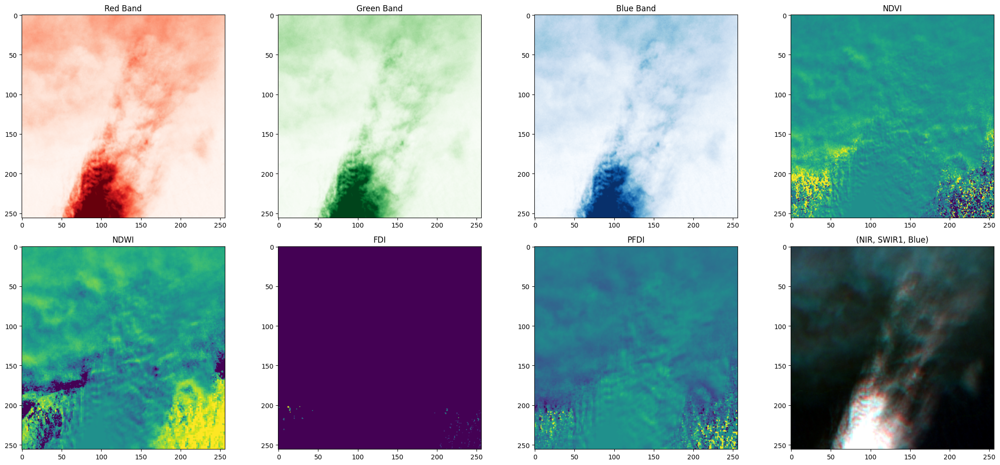

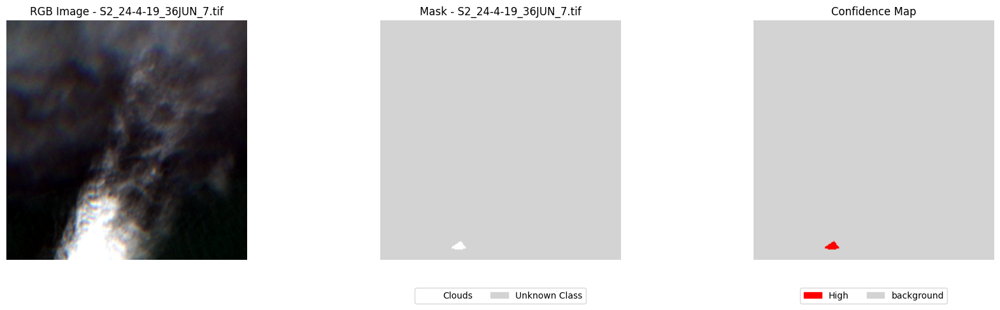

🔍 Visualizing sample 2: S2_7-10-18_52SDD_8.tif
Image shape: (256, 256, 9)
Unique classes in Mask: [ 0  4  7 10]
Unique classes in Confidence: [0 1 2 3]


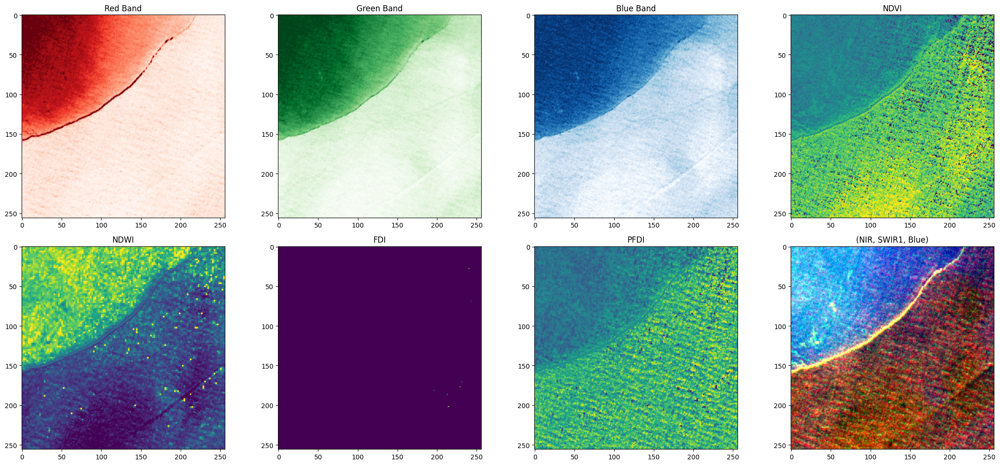

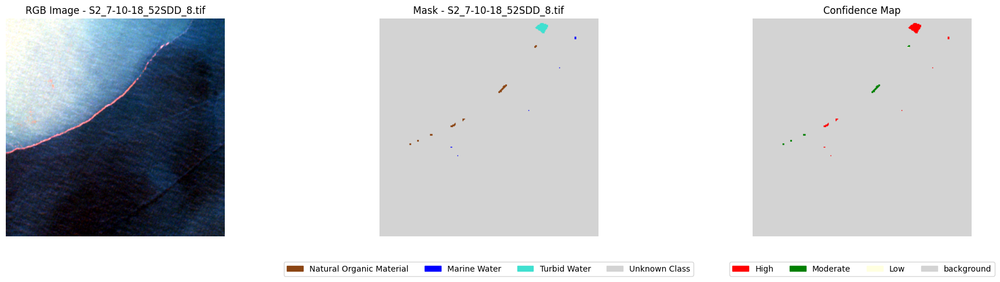

🔍 Visualizing sample 3: S2_9-10-17_16PEC_14.tif
Image shape: (256, 256, 9)
Unique classes in Mask: [ 0  6  7 13]
Unique classes in Confidence: [0 1]


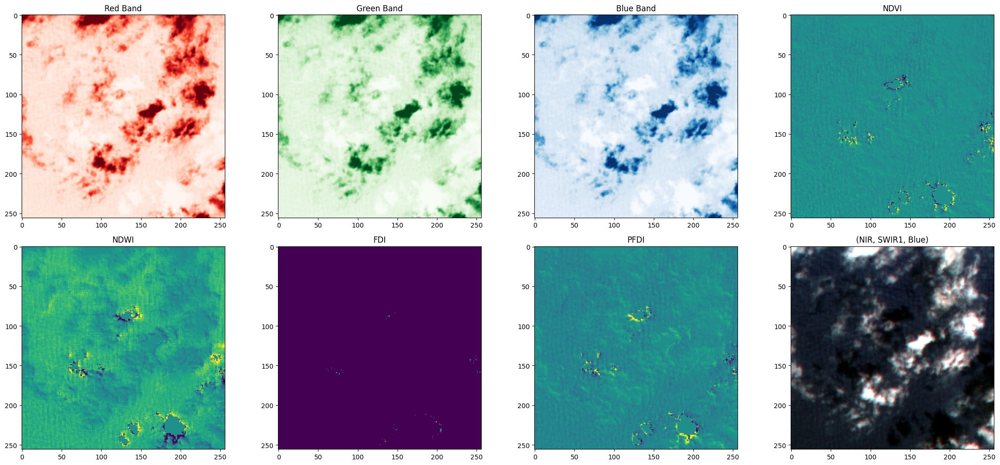

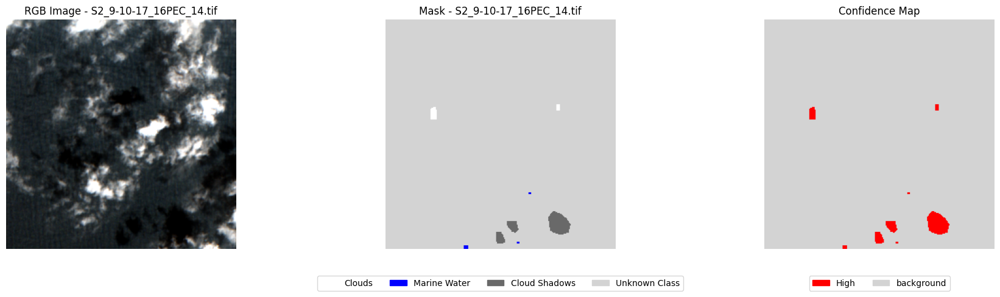

🔍 Visualizing sample 4: S2_4-9-19_16PCC_30.tif
Image shape: (256, 256, 9)
Unique classes in Mask: [0 6 7]
Unique classes in Confidence: [0 1]


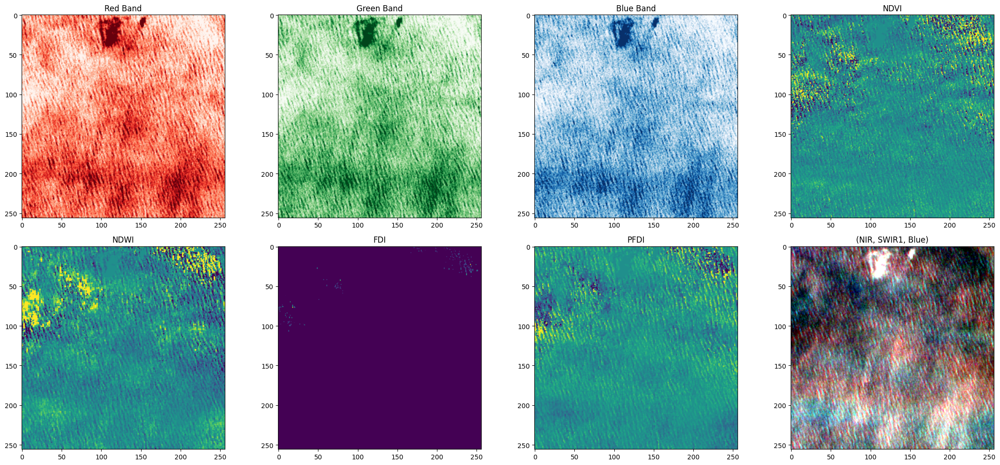

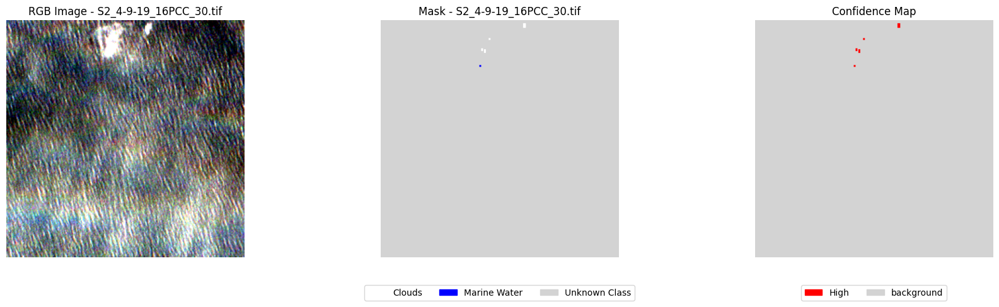

🔍 Visualizing sample 5: S2_18-9-20_16PCC_17.tif
Image shape: (256, 256, 9)
Unique classes in Mask: [ 0  1  7 15]
Unique classes in Confidence: [0 1 2 3]


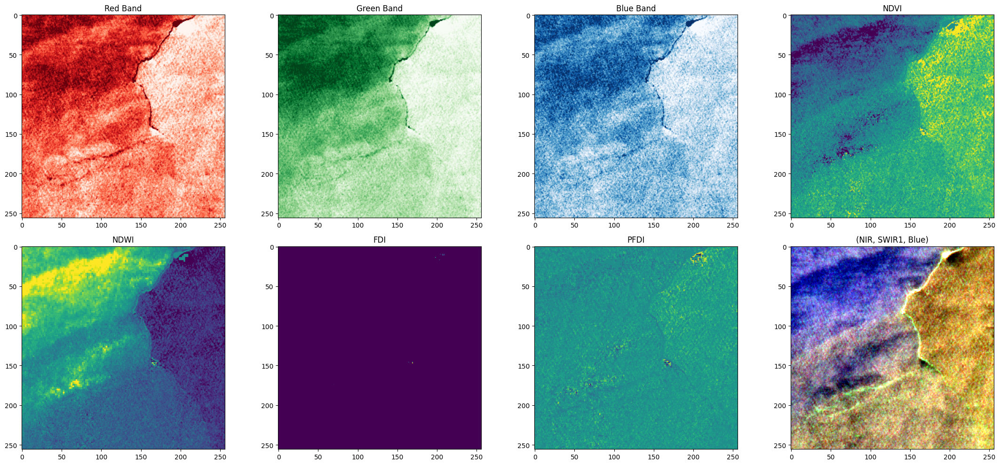

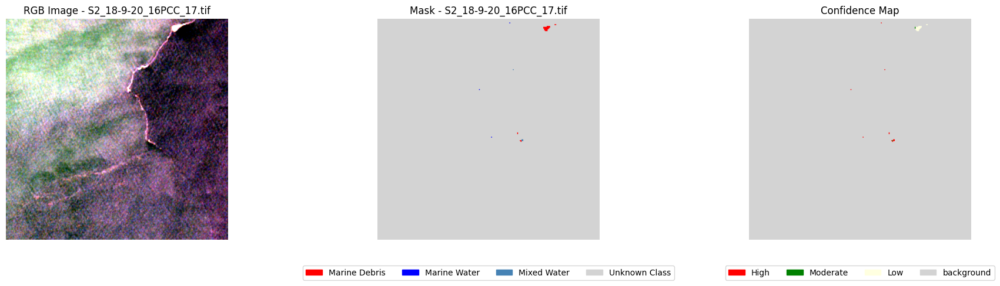

🔍 Visualizing sample 6: S2_13-12-18_16PCC_6.tif
Image shape: (256, 256, 9)
Unique classes in Mask: [ 0  7 11]
Unique classes in Confidence: [0 1]


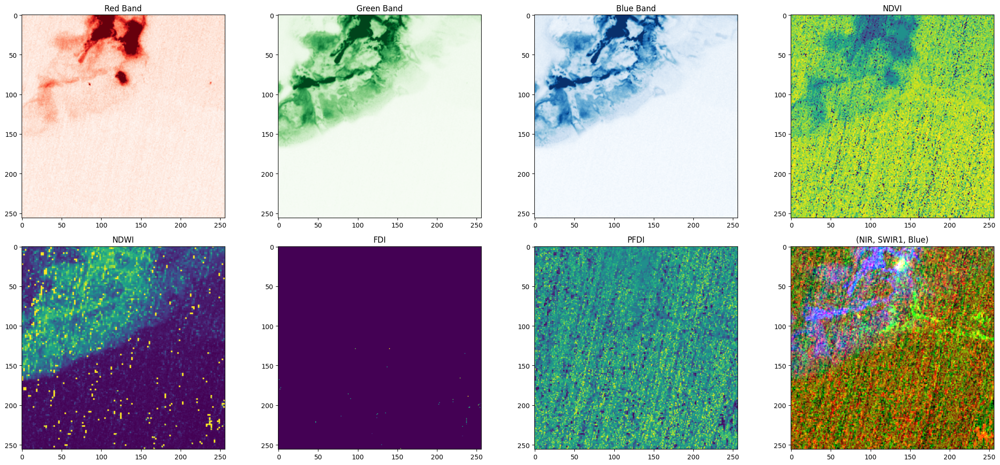

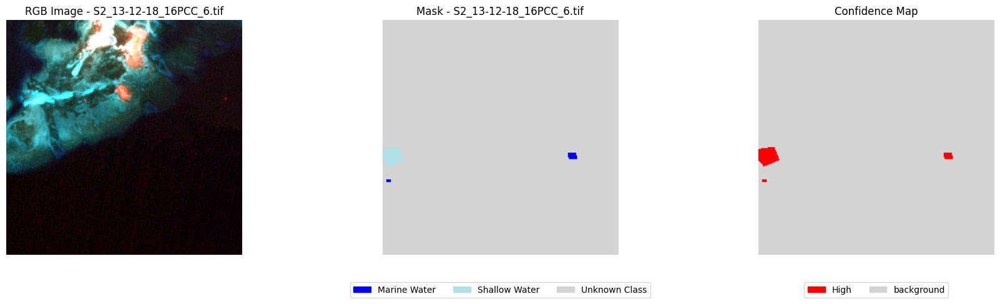

In [10]:
pipeline = DataPipeline(
    img_size=IMG_SIZE,
    num_classes=NUM_CLASSES,
    normalization_method='percentile'
)
visualizer = Visualizer(pipeline, class_mapping, confidence_mapping, color_mapping)
process_and_visualize_samples(
    image_file_path="../data/splits/train_X.txt",
    mask_file_path="../data/splits/train_masks.txt",
    conf_file_path="../data/splits/train_confidence.txt",
    visualizer=visualizer,
    num_images=6,
    save_dir="visualized_outputs"
)

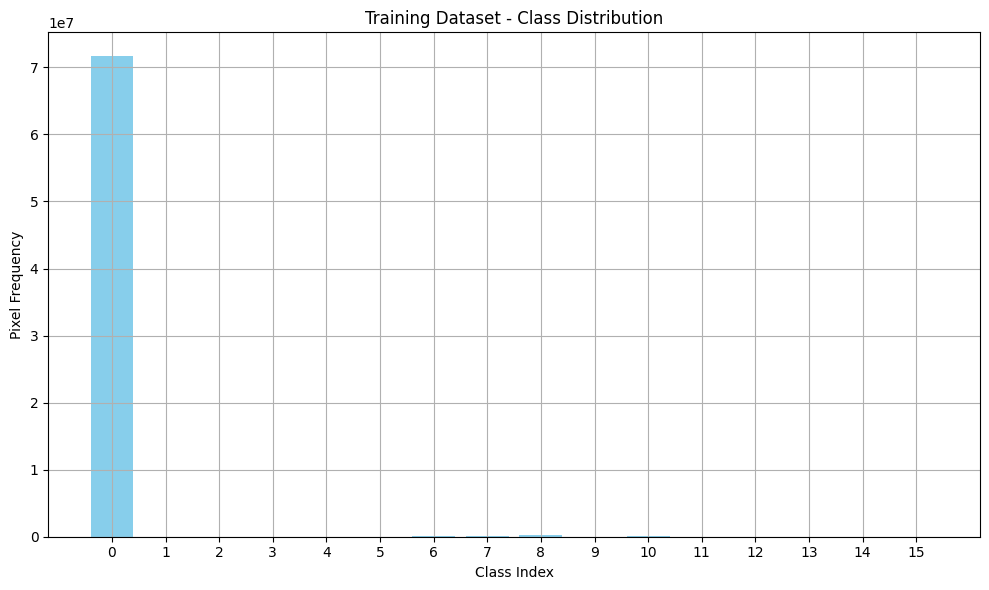

In [11]:

def check_class_distribution(dataset, num_classes, name="Training"):
    """
    Analyzes and visualizes class distribution in a segmentation dataset.
    
    Args:
        dataset (tf.data.Dataset): Dataset yielding (image, mask) pairs.
        num_classes (int): Total number of classes.
        name (str): Label for the dataset (Training/Validation/Test).
        
    Returns:
        np.ndarray: Array containing pixel count per class.
    """
    class_counts = np.zeros(num_classes)

    for _, mask in dataset:
        mask = tf.argmax(mask, axis=-1)  # Convert one-hot to class index
        mask = tf.reshape(mask, [-1])
        mask_np = mask.numpy()
        for class_idx in range(num_classes):
            class_counts[class_idx] += np.sum(mask_np == class_idx)

    # Plot the distribution
    plt.figure(figsize=(10, 6))
    plt.bar(range(num_classes), class_counts, color='skyblue')
    plt.xlabel('Class Index')
    plt.ylabel('Pixel Frequency')
    plt.title(f'{name} Dataset - Class Distribution')
    plt.xticks(range(num_classes))
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    return class_counts
distribution = check_class_distribution(train_dataset, num_classes=NUM_CLASSES, name="Training")


In [94]:
# ----------------------- compute_class_weights ----------------------- #
def compute_class_weights(dataset):
    """Compute class weights based on pixel frequency in the dataset."""
    all_labels = []
    for _, mask in dataset:
        mask_np = mask.numpy().argmax(axis=-1).flatten()
        all_labels.extend(mask_np)
    class_counts = Counter(all_labels)
    # print(f"class_counts: {class_counts}")
    total_pixels = sum(class_counts.values())
    class_weights = {cls: total_pixels / (len(class_counts) * count) for cls, count in class_counts.items()}
    for i in range(NUM_CLASSES):
        if i not in class_weights:
            class_weights[i] = 1.0  # default weight
    return np.array([class_weights[i] for i in range(NUM_CLASSES)])


Unique class values in training masks: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]
Class Weights:
 [6.31147499e-02 1.68228571e+03 2.25760559e+03 2.24527507e+03
 7.46201980e+03 9.83681531e+02 5.02481749e+01 4.63797988e+01
 1.38059828e+01 4.32725742e+03 3.22184191e+01 2.80085723e+02
 1.02632410e+03 4.70109575e+02 7.68000000e+02 1.39137969e+04]
Class  0 → Weight: 0.0631
Class  1 → Weight: 1682.2857
Class  2 → Weight: 2257.6056
Class  3 → Weight: 2245.2751
Class  4 → Weight: 7462.0198
Class  5 → Weight: 983.6815
Class  6 → Weight: 50.2482
Class  7 → Weight: 46.3798
Class  8 → Weight: 13.8060
Class  9 → Weight: 4327.2574
Class 10 → Weight: 32.2184
Class 11 → Weight: 280.0857
Class 12 → Weight: 1026.3241
Class 13 → Weight: 470.1096
Class 14 → Weight: 768.0000
Class 15 → Weight: 13913.7969


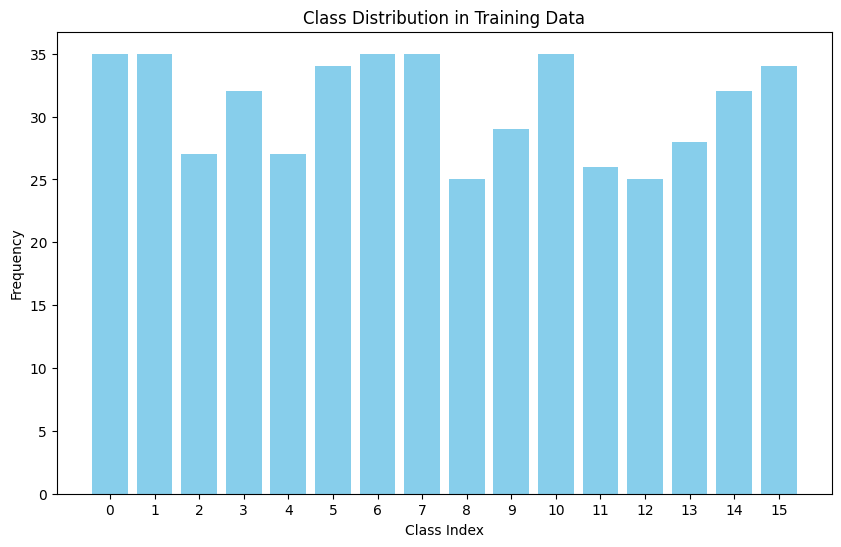

In [13]:
# ----------------------- ANALYSIS & VISUALIZATION  ----------------------- #

def find_unique_classes(dataset):
    """Find unique class indices in the mask labels."""
    unique_classes = set()
    for _, mask in dataset:
        mask_np = np.argmax(mask.numpy(), axis=-1)  # Convert one-hot to class indices
        unique_classes.update(np.unique(mask_np))
    return sorted(unique_classes)


    return np.array([class_weights[i] for i in range(NUM_CLASSES)])
    # return class_weights

def check_class_distribution(dataset):
    """Check class frequency across the dataset."""
    class_counts = np.zeros(NUM_CLASSES)
    for _, mask in dataset:
        mask_indices = np.argmax(mask.numpy(), axis=-1)
        for c in np.unique(mask_indices):
            class_counts[c] += 1
    return class_counts


unique_classes = find_unique_classes(train_dataset)
print(f"Unique class values in training masks: {unique_classes}")

class_weights_array = compute_class_weights(train_dataset)
print("Class Weights:\n", class_weights_array)



for idx, weight in enumerate(class_weights_array):
    print(f"Class {idx:2d} → Weight: {weight:.4f}")
    
distribution = check_class_distribution(train_dataset)
plt.figure(figsize=(10, 6))
plt.bar(range(NUM_CLASSES), distribution, color='skyblue')
plt.xlabel('Class Index')
plt.ylabel('Frequency')
plt.title('Class Distribution in Training Data')
plt.xticks(range(NUM_CLASSES), labels=[str(i ) for i in range(NUM_CLASSES)])
plt.show()

# Modeling

In [133]:
# --------------------------- U-Net Architecture --------------------------- #

def unet_model(input_size,num_classes):
    """
    Builds a U-Net model for semantic segmentation.
    Args:
        input_size (tuple): Shape of the input image.
        num_classes (int): Number of output classes.
    Returns:
        keras.Model: Compiled U-Net model.
    """
    
    tf.keras.backend.clear_session()
    inputs = layers.Input(input_size)
    
    def conv_block(x, filters):
        # x = layers.Conv2D(filters, (3, 3), activation="relu", padding="same", kernel_regularizer=tf.keras.regularizers.l2(1e-4))(x)
        # x = layers.Dropout(0.2)(x)
        # x = layers.Conv2D(filters, (3, 3), activation="relu", padding="same", kernel_regularizer=tf.keras.regularizers.l2(1e-4))(x)
        # return x
        x = layers.Conv2D(filters, (3, 3), activation="relu", padding="same")(x)
        x = layers.Conv2D(filters, (3, 3), activation="relu", padding="same")(x)
        return x
    
    def upsample_block(x, skip, filters):
        x = layers.Conv2DTranspose(filters, (2, 2), strides=(2, 2), padding="same")(x)
        x = layers.concatenate([x, skip])
        return conv_block(x, filters)
    
    # Encoder
    c1 = conv_block(inputs, 64)
    p1 = layers.MaxPooling2D((2, 2))(c1)
    
    c2 = conv_block(p1, 128)
    p2 = layers.MaxPooling2D((2, 2))(c2)
    
    c3 = conv_block(p2, 256)
    p3 = layers.MaxPooling2D((2, 2))(c3)
    
    c4 = conv_block(p3, 512)
    p4 = layers.MaxPooling2D((2, 2))(c4)
    
    # Bottleneck
    c5 = conv_block(p4, 1024)
    
    # Decoder
    u6 = upsample_block(c5, c4, 512)
    u7 = upsample_block(u6, c3, 256)
    u8 = upsample_block(u7, c2, 128)
    u9 = upsample_block(u8, c1, 64)
    
    # Output layer
    outputs = layers.Conv2D(num_classes, (1, 1), activation="softmax")(u9)
    return Model(inputs, outputs)

# ------------------------ Weighted Loss Function ------------------------- #
def weighted_categorical_crossentropy(class_weights_array):
    """
    Custom loss function that applies class weights to the categorical crossentropy.
    Args:
        class_weights_array (tf.Tensor): Array of class weights.
    Returns:
        function: Weighted loss function.
    """
   
    def loss(y_true, y_pred):
        # Calculate categorical crossentropy loss for each pixel/class
        cross_entropy = CategoricalCrossentropy(from_logits=False)(y_true, y_pred) # from_logits is False becout theactivation="softmax" give probabilities not logits
        weights = tf.reduce_sum(y_true * class_weights_array, axis=-1) # Weight for each pixel
        return tf.reduce_mean(cross_entropy * weights)  # Return the weighted cross entropy loss (mean across the batch)
    return loss


# ------------------------ Custom focal loss function ------------------------- #
def focal_loss(gamma=2.0, alpha=0.25):
# gamma = 2.0 (focusing on harder-to-classify regions)
# # alpha = 0.25 (balancing the classes if the foreground is underrepresented) 
    def loss(y_true, y_pred):
        y_true = tf.cast(y_true, tf.float32)
        y_pred = tf.clip_by_value(y_pred, 1e-7, 1.0)
        cross_entropy = -y_true * tf.math.log(y_pred)
        weight = alpha * tf.pow(1 - y_pred, gamma)
        return tf.reduce_sum(weight * cross_entropy, axis=-1)
    return loss




# ---------------------- CUSTOM METRICS ---------------------- #
class MeanIoUWrapper(tf.keras.metrics.MeanIoU):
    """
    Wrapper for MeanIoU to apply argmax before computing the metric.
    """
    def __init__(self, num_classes, name="mean_io_u", **kwargs):
        super(MeanIoUWrapper, self).__init__(num_classes=num_classes, name=name, **kwargs)
        self.num_classes = num_classes
        
    def update_state(self, y_true, y_pred, sample_weight=None):
        y_true = tf.argmax(y_true, axis=-1)
        y_pred = tf.argmax(y_pred, axis=-1)
        return super().update_state(y_true, y_pred, sample_weight)

# class F1Score(tf.keras.metrics.Metric):
#     """
#     Custom F1 Score metric for multi-class segmentation.
#     """
#     def __init__(self, name="f1_score", **kwargs):
#         super().__init__(name=name, **kwargs)
#         self.f1 = self.add_weight(name="f1", initializer="zeros")
#         self.count = self.add_weight(name="count", initializer="zeros")

#     def update_state(self, y_true, y_pred, sample_weight=None):
#         y_true = tf.argmax(y_true, axis=-1)
#         y_pred = tf.argmax(y_pred, axis=-1)
#         y_true = tf.reshape(y_true, [-1])
#         y_pred = tf.reshape(y_pred, [-1])
#         tp = tf.reduce_sum(tf.cast(y_true == y_pred, tf.float32))
#         total = tf.cast(tf.size(y_true), tf.float32)
        
#         f1 = 2 * (tp / (total + 1e-7)) ** 2 / (tp / (total + 1e-7) + 1e-7)
#         self.f1.assign_add(f1)
#         self.count.assign_add(1.0)

#     def result(self):
#         return self.f1 / self.count

#     def reset_state(self):
#         self.f1.assign(0.0)
#         self.count.assign(0.0)

class F1Score(tf.keras.metrics.Metric):
    def __init__(self, num_classes, name="f1_score", **kwargs):
        super(F1Score, self).__init__(name=name, **kwargs)
        self.num_classes = num_classes
        self.tp = self.add_weight(name="tp", shape=(num_classes,), initializer="zeros")
        self.fp = self.add_weight(name="fp", shape=(num_classes,), initializer="zeros")
        self.fn = self.add_weight(name="fn", shape=(num_classes,), initializer="zeros")

    def update_state(self, y_true, y_pred, sample_weight=None):
        # Convert from one-hot to integer labels
        y_true = tf.argmax(y_true, axis=-1)
        y_pred = tf.argmax(y_pred, axis=-1)

        # Flatten
        y_true = tf.reshape(y_true, [-1])
        y_pred = tf.reshape(y_pred, [-1])

        cm = tf.math.confusion_matrix(y_true, y_pred, num_classes=self.num_classes, dtype=tf.float32)
        tp = tf.linalg.diag_part(cm)
        fp = tf.reduce_sum(cm, axis=0) - tp
        fn = tf.reduce_sum(cm, axis=1) - tp

        self.tp.assign_add(tp)
        self.fp.assign_add(fp)
        self.fn.assign_add(fn)

    def result(self):
        precision = self.tp / (self.tp + self.fp + 1e-7)
        recall = self.tp / (self.tp + self.fn + 1e-7)
        f1 = 2 * precision * recall / (precision + recall + 1e-7)
        return tf.reduce_mean(f1)

    def reset_state(self):
        self.tp.assign(tf.zeros_like(self.tp))
        self.fp.assign(tf.zeros_like(self.fp))
        self.fn.assign(tf.zeros_like(self.fn))




def iou_score(y_true, y_pred, smooth=1e-6):
    """
    Computes mean IoU across all classes for one-hot encoded masks.
    """
    y_true = tf.cast(y_true, tf.float32)
    y_pred = tf.cast(y_pred, tf.float32)

    # Flatten height and width
    y_true = tf.reshape(y_true, [-1, tf.shape(y_true)[-1]])
    y_pred = tf.reshape(y_pred, [-1, tf.shape(y_pred)[-1]])

    intersection = tf.reduce_sum(y_true * y_pred, axis=0)
    union = tf.reduce_sum(y_true + y_pred, axis=0) - intersection
    iou = (intersection + smooth) / (union + smooth)

    return tf.reduce_mean(iou)


# lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
#     initial_learning_rate=1e-5,
#     decay_steps=10000,
#     decay_rate=0.9
# )


# ---------------------- BUILD AND TRAIN MODEL ---------------------- #
model = unet_model(input_size=(256, 256, 9), num_classes=NUM_CLASSES)
model.summary()

optimizer = tf.keras.optimizers.legacy.Adam(learning_rate=1e-4)#, clipnorm=1.0) #clipvalue=1.0) +1
class_weights_array = tf.constant(compute_class_weights(train_dataset), dtype=tf.float32)

model.compile(
    optimizer=optimizer,
    loss=weighted_categorical_crossentropy(class_weights_array),
    # loss=CategoricalCrossentropy(from_logits=False),
    metrics=[MeanIoUWrapper(NUM_CLASSES), F1Score(NUM_CLASSES),iou_score]
)


callbacks = [
    tf.keras.callbacks.EarlyStopping(patience=10, restore_best_weights=True),
    tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=1e-6)
]


Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 256, 256, 9)]        0         []                            
                                                                                                  
 conv2d (Conv2D)             (None, 256, 256, 64)         5248      ['input_1[0][0]']             
                                                                                                  
 conv2d_1 (Conv2D)           (None, 256, 256, 64)         36928     ['conv2d[0][0]']              
                                                                                                  
 max_pooling2d (MaxPooling2  (None, 128, 128, 64)         0         ['conv2d_1[0][0]']            
 D)                                                                                           

In [ ]:
model.fit(train_dataset, validation_data=val_dataset, epochs=EPOCHS, callbacks=callbacks)

# ------------------------------- Evaluation ----------------------------- #
test_loss, test_mean_iou, test_f1_score ,iou_score = model.evaluate(test_dataset)
print("\n🧪 Evaluation Results on Test Dataset:")
print(f"   - Loss       : {test_loss:.4f}")
print(f"   - Mean IoU   : {test_mean_iou:.4f}")
print(f"   - F1 Score   : {test_f1_score:.4f}")
print(f"   - iou_score   : {iou_score:.4f}")


model.save("../models/unet_plastic_segmentation.keras")
print("✅ Training Complete!")


# Test

1/1 [==============================] - 0s 190ms/step


2025-04-07 16:25:24.717506: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:117] Plugin optimizer for device_type GPU is enabled.


Predicted mask shape: (32, 256, 256, 16)
Unique classes in predicted mask: [0]
Unique classes in ground truth mask: [ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15]


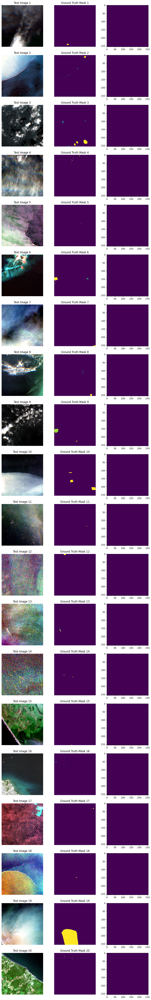

In [16]:
# Load the trained model
model_loaded = load_model("../models/unet_plastic_segmentation.keras", compile=False)

# Get a batch of test images and ground truth masks
sample_img, sample_mask = next(iter(train_dataset))  # Use test_dataset instead of train_dataset

# Get model predictions
pred_mask = model_loaded.predict(sample_img)

# Print the shape of the predicted mask
print("Predicted mask shape:", pred_mask.shape)  # Should be (batch_size, height, width, num_classes)

# Get unique classes in the predicted mask and ground truth mask
unique_classes_pred = np.unique(np.argmax(pred_mask, axis=-1))
unique_classes_true = np.unique(np.argmax(sample_mask, axis=-1))

print("Unique classes in predicted mask:", unique_classes_pred)
print("Unique classes in ground truth mask:", unique_classes_true)

# Number of images to visualize
num_images_to_show = min(20, sample_img.shape[0])  # Show up to 5 images

# Plot test image, ground truth mask, and predicted mask
fig, axes = plt.subplots(num_images_to_show, 3, figsize=(12, 4 * num_images_to_show))

for i in range(num_images_to_show):
    ax1, ax2, ax3 = axes[i]
    
      # Display the test image as RGB with custom channel indices
    rgb_image = np.stack([
        sample_img[i, :, :, 0],  # Red channel (index 1)
        sample_img[i, :, :, 1],  # Green channel (index 2)
        sample_img[i, :, :, 2]   # Blue channel (index 3)
    ], axis=-1)    
    # Display the test image
    ax1.imshow(rgb_image)
    ax1.set_title(f"Test Image {i+1}")
    ax1.axis('off')

    # Display the ground truth mask
    ax2.imshow(np.argmax(sample_mask[i], axis=-1))
    ax2.set_title(f"Ground Truth Mask {i+1}")
    ax2.axis('off')

    # Display the predicted mask
    ax3.imshow(np.argmax(pred_mask[i], axis=-1))


# Pretrained Models 

In [129]:
# from keras_cv.models.segmentation import DeepLabV3Plus
from tensorflow.keras.applications import ResNet50



In [134]:

def build_resnet50_backbone(input_tensor):
    """
    Custom ResNet50 backbone for 9-band input.
    """
    x = layers.Conv2D(64, (7, 7), strides=(2, 2), padding='same', use_bias=False)(input_tensor)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)
    x = layers.MaxPooling2D((3, 3), strides=(2, 2), padding='same')(x)

    base_model = ResNet50(include_top=False, weights=None, input_tensor=x)
    return base_model

def DeeplabV3Plus(input_shape=(256, 256, 3), num_classes=16):
    """
    DeepLabV3+ with custom ResNet50 backbone that accepts 9-band inputs.
    """
    inputs = layers.Input(shape=input_shape)
    base_model = build_resnet50_backbone(inputs)

    # Deep and skip features
    deep_feature = base_model.get_layer("conv4_block6_2_relu").output  # 1/16 scale
    skip_feature = base_model.get_layer("conv2_block3_2_relu").output  # 1/4 scale

    # ASPP (simple 1x1)
    x = layers.Conv2D(256, 1, padding="same", activation="relu")(deep_feature)
    x = layers.BatchNormalization()(x)
    x = layers.UpSampling2D(size=(4, 4), interpolation="bilinear")(x)  # Now x is 1/4 scale (64x64)

    # Process skip connection and upsample it (just in case it's not exactly 64x64)
    skip = layers.Conv2D(48, 1, padding="same", activation="relu")(skip_feature)
    skip = layers.BatchNormalization()(skip)
    skip = layers.UpSampling2D(size=(1, 1), interpolation="bilinear")(skip)  # No change, ensures shape alignment

    # Concatenate
    x = layers.Concatenate()([x, skip])
    x = layers.Conv2D(256, 3, padding="same", activation="relu")(x)
    x = layers.BatchNormalization()(x)
    x = layers.Conv2D(256, 3, padding="same", activation="relu")(x)
    x = layers.BatchNormalization()(x)

    # Final upsample to original resolution (256x256)
    x = layers.UpSampling2D(size=(4, 4), interpolation="bilinear")(x)
    x = layers.UpSampling2D(size=(4, 4), interpolation="bilinear")(x)  # (None, 256, 256, ...)
    print(x.shape)
    outputs = layers.Conv2D(num_classes, 1, activation="softmax")(x)
    
    print("After upsampling:", x.shape)  # Should now show (None, 256, 256, 256)

    return models.Model(inputs=inputs, outputs=outputs)


In [135]:
model_resNet = DeeplabV3Plus(input_shape=(256, 256, 3), num_classes=NUM_CLASSES)
model_resNet.summary()

optimizer = tf.keras.optimizers.legacy.Adam(learning_rate=1e-4)

model_resNet.compile(
    optimizer=optimizer,
    loss=weighted_categorical_crossentropy(class_weights_array),
    # loss=CategoricalCrossentropy(from_logits=False),
    metrics=[MeanIoUWrapper(NUM_CLASSES), F1Score(NUM_CLASSES), iou_score]
)




(None, 256, 256, 256)
After upsampling: (None, 256, 256, 256)
Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_2 (InputLayer)        [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 conv2d_19 (Conv2D)          (None, 128, 128, 64)         9408      ['input_2[0][0]']             
                                                                                                  
 batch_normalization (Batch  (None, 128, 128, 64)         256       ['conv2d_19[0][0]']           
 Normalization)                                                                                   
                                                                                                  
 re_lu (ReLU)                (

In [136]:
model_resNet.fit(train_dataset, validation_data=val_dataset, epochs=EPOCHS, callbacks=callbacks)

# ------------------------------- Evaluation ----------------------------- #
test_loss, test_mean_iou, test_f1_score ,iou_score = model_resNet.evaluate(test_dataset)
print("\n🧪 Evaluation Results on Test Dataset:")
print(f"   - Loss       : {test_loss:.4f}")
print(f"   - Mean IoU   : {test_mean_iou:.4f}")
print(f"   - F1 Score   : {test_f1_score:.4f}")
print(f"   - iou_score   : {iou_score:.4f}")


model.save("../models/unet_plastic_segmentation_ResNet.keras")
print("✅ Training Complete!")

Epoch 1/120
35/35 [==============================] - 44s 1s/step - loss: 3.1248 - mean_io_u: 0.0051 - f1_score: 0.0096 - iou_score: 0.0046 - val_loss: 2.9033 - val_mean_io_u: 0.0311 - val_f1_score: 0.0415 - val_iou_score: 0.0051 - lr: 1.0000e-04
Epoch 2/120
35/35 [==============================] - 39s 1s/step - loss: 2.7065 - mean_io_u: 0.0121 - f1_score: 0.0207 - iou_score: 0.0048 - val_loss: 2.7207 - val_mean_io_u: 0.0321 - val_f1_score: 0.0424 - val_iou_score: 0.0060 - lr: 1.0000e-04
Epoch 3/120
35/35 [==============================] - 39s 1s/step - loss: 2.6189 - mean_io_u: 0.0319 - f1_score: 0.0428 - iou_score: 0.0052 - val_loss: 2.5818 - val_mean_io_u: 0.0371 - val_f1_score: 0.0466 - val_iou_score: 0.0067 - lr: 1.0000e-04
Epoch 4/120
35/35 [==============================] - 40s 1s/step - loss: 2.5412 - mean_io_u: 0.0480 - f1_score: 0.0549 - iou_score: 0.0055 - val_loss: 2.4562 - val_mean_io_u: 0.0470 - val_f1_score: 0.0537 - val_iou_score: 0.0075 - lr: 1.0000e-04
Epoch 5/120
35/3